# Segmentation using Dense Conditional Random Fields (CRFs)

Goal: to exemplify efficacy of DenseCRF.  
Author: Lucas David -- <lucas.david@ic.unicamp.br>

In [1]:
IS_COLAB = False

if IS_COLAB:
    base_dir = '/content/drive/Shareddrives/lerdl'
    logs_dir = f'{base_dir}/logs'
    model_dir = f'{base_dir}/models'
else:
    base_dir = '/data'
    logs_dir = '/logs'
    model_dir = '/logs/models'

In [2]:
import tensorflow as tf

class Config:
  seed = 218402

  class data:
    # size = (528, 528)  # EfficientNetB6
    size = (512, 512)  # ResNet101V2
    # size = (224, 224)  # VGG16
    shape = (*size, 3)
    batch_size = 64
    shuffle_buffer_size = 8 * batch_size
    prefetch_buffer_size = tf.data.experimental.AUTOTUNE
    train_shuffle_seed = 120391
    shuffle = False
    
    data_files = '/data/misc/*.jpg'

  class model:
    kur = False
    weights = f'{model_dir}/coco-2017/rn101'

In [3]:
preprocess = tf.keras.applications.resnet_v2.preprocess_input
deprocess = lambda x: (x + 1) * 127.5
to_image = lambda x: tf.cast(tf.clip_by_value(deprocess(x), 0, 255), tf.uint8)

def masked(x, maps):
  return x * tf.image.resize(maps, Config.data.size)

## Setup

In [4]:
pip -qq install git+https://github.com/lucasb-eyer/pydensecrf.git

Note: you may need to restart the kernel to use updated packages.


In [5]:
import os
import shutil
from time import time
from math import ceil

import numpy as np
import pandas as pd
import tensorflow_datasets as tfds
import matplotlib.pyplot as plt
import seaborn as sns

from tensorflow.keras import callbacks

In [6]:
for d in tf.config.list_physical_devices('GPU'):
  print(d)
  print(f'Setting device {d} to memory-growth mode.')
  try:
    tf.config.experimental.set_memory_growth(d, True)
  except Exception as e:
    print(e)

In [7]:
R = tf.random.Generator.from_seed(Config.seed, alg='philox')
C = np.asarray(sns.color_palette("Set1", 21))
CMAP = sns.color_palette("Set1", 21, as_cmap=True)

sns.set_style("whitegrid", {'axes.grid' : False})

In [8]:
np.set_printoptions(linewidth=120)

In [9]:
def normalize(x, reduce_min=True, reduce_max=True):
  if reduce_min: x -= tf.reduce_min(x, axis=(-3, -2), keepdims=True)
  if reduce_max: x = tf.math.divide_no_nan(x, tf.reduce_max(x, axis=(-3, -2), keepdims=True))

  return x

def visualize(
    image,
    title=None,
    rows=2,
    cols=None,
    i0=0,
    figsize=(9, 4),
    cmap=None,
    full=True
):
  if image is not None:
    if isinstance(image, (list, tuple)) or len(image.shape) > 3:  # many images
      if full: plt.figure(figsize=figsize)
      cols = cols or ceil(len(image) / rows)
      for ix in range(len(image)):
        plt.subplot(rows, cols, i0+ix+1)
        visualize(image[ix],
                 cmap=cmap,
                 title=title[ix] if title is not None and len(title) > ix else None)
      if full: plt.tight_layout()
      return

    if isinstance(image, tf.Tensor): image = image.numpy()
    if image.shape[-1] == 1: image = image[..., 0]
    plt.imshow(image, cmap=cmap)
  
  if title is not None: plt.title(title)
  plt.axis('off')

In [10]:
def observe_labels(probs, labels, ix):
  p = probs[ix]
  l = labels[ix]
  s = tf.argsort(p, direction='DESCENDING')

  d = pd.DataFrame({
    'idx': s,
    'label': tf.gather(CLASSES, s).numpy().astype(str),
    'predicted': tf.gather(p, s).numpy().round(2),
    'ground-truth': tf.gather(l, s).numpy()
  })

  return d[(d['ground-truth']==1) | (d['predicted'] > 0.05)]


def plot_heatmap(i, m):
    plt.imshow(i)
    plt.imshow(m, cmap='jet', alpha=0.5)
    plt.axis('off')

## Data

In [11]:
ds = tf.data.Dataset.list_files(Config.data.data_files, shuffle=False)
ds = ds.map(
    lambda f: tf.image.resize(
        tf.io.decode_jpeg(
            tf.io.read_file(f), channels=3), Config.data.shape[:2]),
    num_parallel_calls=tf.data.AUTOTUNE)

def configure_for_performance(ds):
  ds = ds.cache()
  ds = ds.batch(Config.data.batch_size)
  ds = ds.prefetch(buffer_size=tf.data.AUTOTUNE)
  return ds

ds = configure_for_performance(ds)

In [ ]:
(), info = tfds.load(
  'coco/2017',
  split=[],
  with_info=True,
  shuffle_files=False
)

Dl Completed...: 0 url [00:00, ? url/s]

Dl Size...: 0 MiB [00:00, ? MiB/s]

Extraction completed...: 0 file [00:00, ? file/s]

In [ ]:
CLASSES = np.asarray(info.features['objects']['label']._int2str)
int2str = info.features['objects']['label'].int2str

### Examples in The Dataset

In [ ]:
#@title

for images in ds.take(1):
  visualize(
    to_image(images[:16]),
    rows=2,
    figsize=(16, 9)
  )

## Network

In [20]:
print(f'Loading {Config.model.backbone.__name__}')

backbone = Config.model.backbone(
  input_shape=Config.data.shape,
  include_top=Config.model.include_top,
  classifier_activation=Config.model.classifier_activation,
)

Loading ResNet101V2


In [21]:
from tensorflow.keras.layers import Dense, Dropout, GlobalAveragePooling2D


def build_specific_classifier(
    backbone,
    classes,
    dropout_rate=0.5,
    name=None,
    gpl='avg_pool',
):
  x = backbone.input
  y = backbone.output
  y = GlobalAveragePooling2D(name='avg_pool')(y)
  y = Dropout(rate=dropout_rate, name='top_dropout')(y)
  y = Dense(classes, name='predictions')(y)

  return tf.keras.Model(
    x,
    y,
    name=name
  )

backbone.trainable = False
nn = build_specific_classifier(backbone, len(CLASSES), name=f'{type(backbone).__name__}_voc_20')

In [22]:
from tensorflow.keras.layers import Dense, Dropout, GlobalAveragePooling2D


class DenseSoftmaxWeights(Dense):
  """Dense with Softmax Weights.
  """
  def call(self, inputs):
    kernel = self.kernel
    ag = kernel  # tf.abs(kernel)
    ag = ag - tf.reduce_max(ag, axis=-1, keepdims=True)
    ag = tf.nn.softmax(ag)

    outputs = inputs @ (ag*kernel)

    if self.use_bias:
      outputs = tf.nn.bias_add(outputs, self.bias)

    if self.activation is not None:
      outputs = self.activation(outputs)

    return outputs

In [23]:
from tensorflow.keras.layers import Dense, Dropout, GlobalAveragePooling2D


def build_specific_classifier(
    backbone,
    classes,
    dropout_rate=0.5,
    name=None,
    gpl='avg_pool',
):
  x = tf.keras.Input((Config.data.shape), name='images')
  y = backbone(x)
  y = GlobalAveragePooling2D(name='avg_pool')(y)

  y = Dropout(rate=dropout_rate, name='top_dropout')(y)
  y = DenseSoftmaxWeights(classes, name='predictions')(y)

  return tf.keras.Model(x, y, name=name)

backbone.trainable = False
nn = build_specific_classifier(backbone, len(CLASSES), name=f'{Config.model.backbone.__name__}')

In [24]:
if Config.model.fine_tune_layers:
  print(f'Unfreezing {Config.model.fine_tune_layers:.0%} layers.')

  backbone.trainable = True
  frozen_layer_ix = int((1-Config.model.fine_tune_layers) * len(backbone.layers))

  for ix, l in enumerate(backbone.layers):
    l.trainable = (ix > frozen_layer_ix and
                  (not isinstance(l, tf.keras.layers.BatchNormalization) or
                   not Config.model.freeze_batch_norm))
    
print(f'Loading weights from {Config.model.weights}')
nn.load_weights(Config.model.weights)

Unfreezing 60% layers.
Loading weights from /content/drive/MyDrive/logs/pascal-2012/resnet101-sw-ce-fine-tune/weights.h5


In [25]:
nn_s = tf.keras.Model(
  inputs=nn.inputs,
  outputs=[nn.output, nn.get_layer(Config.model.gap_layer_name).input],
  name='nn_spatial')

In [26]:
sW, sb = nn_s.get_layer('predictions').weights
sW = sW * tf.nn.softmax(sW - tf.reduce_max(sW, axis=-1, keepdims=True))

## Attention Maps

In [27]:
#@title

def create_pascal_label_colormap():
  colormap = np.zeros((256, 3), dtype=int)
  ind = np.arange(256, dtype=int)
  for shift in reversed(range(8)):
    for channel in range(3):
      colormap[:, channel] |= ((ind >> channel) & 1) << shift
    ind >>= 3

  return colormap

def label_to_color_image(label):
  if label.ndim != 2: raise ValueError('Expect 2-D input label')
  if np.max(label) >= len(C): raise ValueError('label value too large.')

  return C[label]

BG_PAD = ((0, 0), (0, 0), (0, 0), (1, 0))
def logits_to_seg_maps(x, bg_t=0.2):
  y = tf.pad(x, BG_PAD, 'CONSTANT', bg_t)  # Add background index 0
  y = tf.argmax(y, axis=-1)                # Infer class-per-pixel
  return y


from matplotlib.patches import Rectangle

def visualize_segmentation(image, seg, detections):
  seg = label_to_color_image(seg).astype(np.uint8)
  plt.imshow(to_image(image))
  plt.imshow(seg, alpha=0.7)
  plt.axis('off')

  if detections.any():
    indices, = np.where(detections)
    plt.legend([Rectangle((0,0),1,1, color=c) for c in C[indices] / 255],
               LABEL_NAMES[detections])

def visualize_segmentation_many(images, maps, preds, figsize=None, label_maps=False):
  N = len(images)
  cols = 4
  rows = ceil(N/4)

  if figsize is None: figsize = (16, 4*rows)
  plt.figure(figsize=figsize)

  for ix in range(N):
    plt.subplot(rows, cols, ix+1)

    if label_maps:
      segs = maps[ix:ix+1]
    else:
      segs = logits_to_seg_maps(maps[ix:ix+1], bg_t=BG_THRESHOLD)

    detecs = np.concatenate(([False], preds[ix].numpy().astype(bool)))
    visualize_segmentation(
      images[ix],
      segs[0],
      detecs)

  plt.tight_layout()

In [28]:
LABEL_NAMES = np.concatenate((['background'], CLASSES))
C = create_pascal_label_colormap()

DETECTION_THRESHOLD = 0.5
BG_THRESHOLD = 0.2

In [29]:
for images, labels in valid.take(1):
  logits, activations = nn_s(images, training=False)
  probs = tf.nn.sigmoid(logits)

  detections = tf.cast(probs > DETECTION_THRESHOLD, tf.float32)

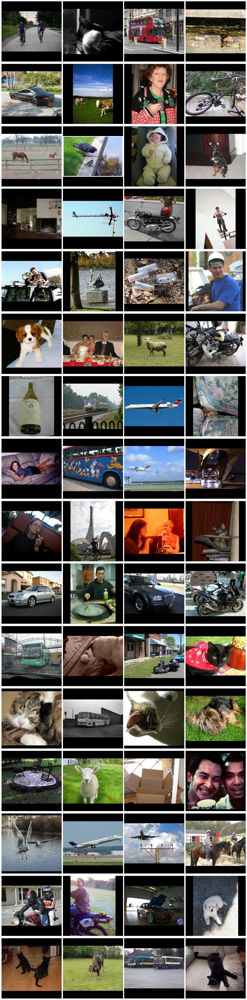

In [ ]:
visualize(to_image(images), rows=16, figsize=(16, 4 * 16))

### CAM

In [ ]:
@tf.function
def cam_fn(activations, weights, detections):
  c = tf.einsum('bhwk,kc,bc->bhwc', activations, weights, detections)
  c = tf.nn.relu(c)
  c = normalize(c)
  c = tf.image.resize(c, Config.data.size)

  return c

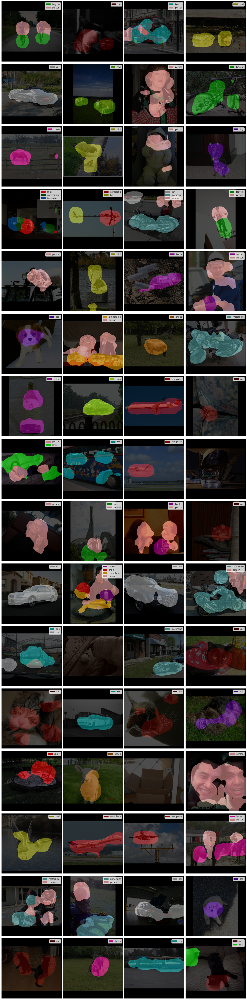

In [ ]:
cams = cam_fn(activations, sW, detections)

visualize_segmentation_many(images, cams, detections)

#### DenseCRF

In [ ]:
from pydensecrf import (densecrf as dcrf,
                        utils as dcrf_utils)


def dense_crf_from_labels(
    img,
    labels,
    n_labels=21,
    gt_prob=0.7,
    MAX_ITER = 10,
    POS_XY_STD=(1, 1),
    POS_W = 3,
    Bi_XY_STD = (80, 80),
    Bi_RGB_STD = (13, 13, 13),
    Bi_W = 10
):
  h = labels.shape[0]
  w = labels.shape[1]

  U = dcrf_utils.unary_from_labels(labels, n_labels, gt_prob, zero_unsure=True)
  U = np.ascontiguousarray(U)

  img = np.ascontiguousarray(img)

  d = dcrf.DenseCRF2D(w, h, n_labels)
  d.setUnaryEnergy(U)
  d.addPairwiseGaussian(sxy=POS_XY_STD,
                        compat=POS_W,
                        kernel=dcrf.DIAG_KERNEL,
                        normalization=dcrf.NORMALIZE_SYMMETRIC)
  d.addPairwiseBilateral(sxy=Bi_XY_STD,
                         srgb=Bi_RGB_STD,
                         rgbim=img,
                         compat=Bi_W,
                         kernel=dcrf.DIAG_KERNEL,
                         normalization=dcrf.NORMALIZE_SYMMETRIC)

  Q = d.inference(MAX_ITER)
  Q = np.array(Q).reshape((n_labels, h, w))
  return Q

In [ ]:
ob = tf.reduce_max(cams, axis=-1, keepdims=True)  # (b, h, w)
bg = BG_THRESHOLD*(1 -ob)
sm = tf.concat((bg, cams), axis=-1)
sm = tf.argmax(sm, -1, tf.int32) + 1

unsure = ((ob > 0.2) & (ob < 0.4))[..., 0]
sm = tf.cast(~unsure, tf.int32) * sm

In [ ]:
%%time

q = [dense_crf_from_labels(to_image(images[ix]).numpy(), sm[ix].numpy())
     for ix in range(len(images))]
q = tf.stack(q, axis=0)
q = tf.transpose(q, (0, 2, 3, 1))

CPU times: user 3min 3s, sys: 27.4 s, total: 3min 30s
Wall time: 3min 28s


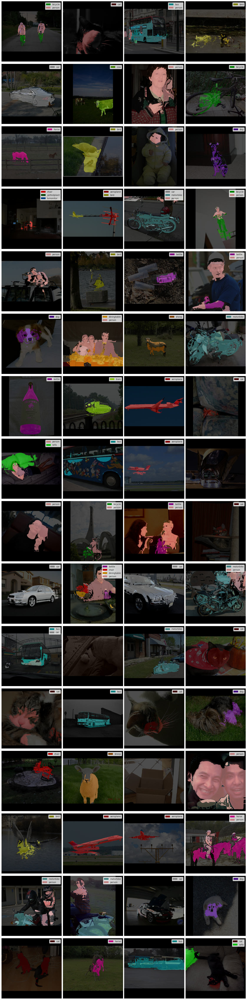

In [ ]:
visualize_segmentation_many(images, tf.argmax(q, axis=-1), detections, label_maps=True)

### D-MinMax-CAM

In [ ]:
@tf.function
def minmax_sigmoid_cam(a, sW, d):
  c = tf.reduce_sum(d, axis=-1)
  c = tf.reshape(c, (-1, 1, 1))     # detections (b, 1)

  w = d[:, tf.newaxis, :] * sW[tf.newaxis, ...]  # expand kernels in d and batches in sW
  w_n = tf.reduce_sum(w, axis=-1, keepdims=True)
  w_n = w_n - w

  w = sW - w_n / tf.maximum(c-1, 1)

  maps = tf.einsum('bhwk,bku,bu->bhwu', a, w, d)
  maps = tf.nn.relu(maps)
  maps = normalize(maps)
  maps = tf.image.resize(maps, Config.data.size)

  return maps

In [ ]:
@tf.function
def d_minmax_sigmoid_cam(a, sW, d):
  c = tf.reshape(tf.reduce_sum(d, axis=-1), (-1, 1, 1))  # select only detected

  w = d[:, tf.newaxis, :] * sW[tf.newaxis, ...]  # expand kernels in d and batches in sW
  wa = tf.reduce_sum(w, axis=-1, keepdims=True)
  wn = wa - w

  w = (tf.nn.relu(sW)
       -tf.nn.relu(wn) / tf.maximum(c-1, 1)
       +tf.minimum(0., wa) / tf.maximum(c, 1))

  maps = tf.einsum('bhwk,bkc,bc->bhwc', a, w, d)
  maps = tf.nn.relu(maps)
  maps = normalize(maps)
  maps = tf.image.resize(maps, Config.data.size)

  return maps

In [ ]:
cams = minmax_sigmoid_cam(activations, sW, detections)

visualize_segmentation_many(images, cams, detections)

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
cams = d_minmax_sigmoid_cam(activations, sW, detections)

visualize_segmentation_many(images, cams, detections)

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
ob = tf.reduce_max(cams, axis=-1, keepdims=True)  # (b, h, w)
bg = BG_THRESHOLD*(1 -ob)
sm = tf.concat((bg, cams), axis=-1)
sm = tf.argmax(sm, -1, tf.int32) + 1

unsure = ((ob > 0.2) & (ob < 0.4))[..., 0]
sm = tf.cast(~unsure, tf.int32) * sm

In [ ]:
%%time

q = [dense_crf_from_labels(to_image(images[ix]).numpy(), sm[ix].numpy())
     for ix in range(len(images))]
q = tf.stack(q, axis=0)
q = tf.transpose(q, (0, 2, 3, 1))

CPU times: user 3min 1s, sys: 27.5 s, total: 3min 28s
Wall time: 3min 26s


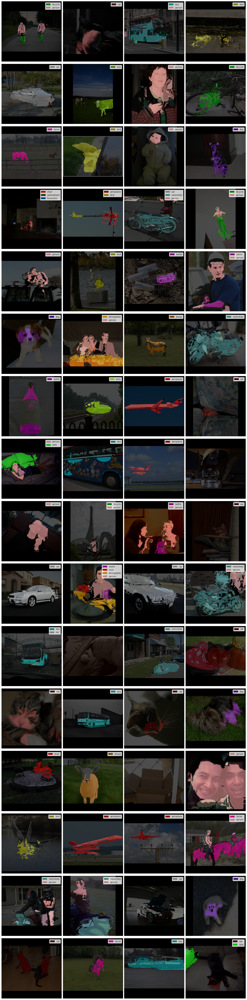

In [ ]:
visualize_segmentation_many(images, tf.argmax(q, axis=-1), detections, label_maps=True)